# Training a Spiking Neural Network on URFD Spiking dataset

For more details on surrogate gradient learning, please see:

> Neftci, E.O., Mostafa, H., and Zenke, F. (2019). Surrogate Gradient Learning in Spiking Neural Networks: Bringing the Power of Gradient-based optimization to spiking neural networks. IEEE Signal Process Mag 36, 51–63.
> https://ieeexplore.ieee.org/document/8891809 and https://arxiv.org/abs/1901.09948

In [1]:
import os
import h5py
import gdown
import zipfile

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
import seaborn as sns
import plotly.graph_objs as go
from plotly.offline import iplot

from sklearn.model_selection import train_test_split
import torch
import torch.nn as nn
from torch.utils import data

In [2]:
import torch
print(torch.__version__)

2.2.0+cu121


In [3]:
# # Specify the dataset directory 
# dataset_dir = '../data/urfd-spiking-dataset-240'

# # Check if it exists
# if not os.path.exists(dataset_dir):
#     os.makedirs(dataset_dir)
    
#     # Google Drive file ID
#     file_id = '1eV19cNhCup_uk3pYWIZFP9eeb3Mj4mNk'
#     # Destination filename
#     destination = '../data/urfd-spiking-dataset-240.zip'
#     # Download URL
#     url = f'https://drive.google.com/uc?id={file_id}'

#     # Download the file from Google Drive
#     gdown.download(url, destination, quiet=False)

#     # Extract the zip file
#     with zipfile.ZipFile(destination, 'r') as zip_ref:
#         zip_ref.extractall(dataset_dir)

#     print(f'Dataset extracted to {dataset_dir}')


In [4]:
# The coarse network structure and the time steps are dicated by the dataset.
FRAME_WIDTH = 240
FRAME_HEIGHT = 180

nb_inputs  = FRAME_WIDTH * FRAME_HEIGHT
nb_hidden  = 5000
nb_outputs = 2

time_step = 1e-2
nb_steps = 1000
max_time = 40.0

batch_size = 5

In [5]:
dtype = torch.float

# Check whether a GPU is available
if torch.cuda.is_available():
    device = torch.device("cuda")
else:
    device = torch.device("cpu")

print(device)

cuda


### Setup the spiking dataset

Each video frame has 240x180 pixels which could be spiking at any given timestamp. A h5 events file contains these spikes as (timestamp, x, y, polarity) tuples.

In [6]:
# Here we load the Dataset
dataset_folder = "../data/urfd-spiking-dataset-240"
folders = os.listdir(dataset_folder)

samples = []
labels = []
max_timestamp = 0.0

for folder in folders:
    events_file = folder + '.h5'
    try:
      spike_data = h5py.File(os.path.join(dataset_folder, folder, events_file), 'r')

      spike_tuples = np.array(spike_data["events"])
      sample = {
        'timestamp': spike_tuples[:, 0] / 1e6,
        'x': spike_tuples[:, 1],
        'y': spike_tuples[:, 2],
        'polarity': spike_tuples[:, 3]
      }

      sample_max = sample["timestamp"].max()
      if sample_max > max_timestamp:
        max_timestamp = sample_max

      samples.append(sample)
      labels.append(1 if "fall" in folder else 0)

    except Exception as e:
      print(f"Error in {events_file}")
      print(e)

x_train, x_test, y_train, y_test = train_test_split(samples, labels, test_size=0.2, random_state=42)

print(f"No of samples: {len(labels)}")
print(f"Maximum timestamp: {max_timestamp}")

Error in labels.csv.h5
[Errno 2] Unable to synchronously open file (unable to open file: name = '../data/urfd-spiking-dataset-240\labels.csv\labels.csv.h5', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)
No of samples: 70
Maximum timestamp: 13.3


In order to use the data for learning with our spiking network, we also need to discretize the spike times into n_steps bins. Note that the max_time argument that forms the upper limit of the bins.

In [7]:
def sparse_data_generator_from_hdf5_spikes(X, y, batch_size, nb_steps, nb_units, max_time, shuffle=True):
    """ This generator takes a spike dataset and generates spiking network input as sparse tensors.


    Args:
        X: The data ( sample x event x 4 ) the last dim holds (timestamp (s), x, y, polarity) tuples
        y: The labels
    """

    labels_ = np.array(y, dtype=int)
    number_of_batches = len(labels_)//batch_size
    sample_index = np.arange(len(labels_))

    # compute discrete firing times
    firing_times = []
    x_pixels = []
    y_pixels = []
    # units_fired = X['units']

    for sample in X:
        firing_times.append(sample["timestamp"])
        x_pixels.append(sample["x"])
        y_pixels.append(sample["y"])

    time_bins = np.linspace(0, max_time, num=nb_steps)

    if shuffle:
        np.random.shuffle(sample_index)

    total_batch_count = 0
    counter = 0
    while counter<number_of_batches:
        batch_index = sample_index[batch_size*counter:batch_size*(counter+1)]

        coo = [ [] for i in range(3) ]
        for bc,idx in enumerate(batch_index):
            times = np.digitize(firing_times[idx], time_bins)
            units = y_pixels[idx] * FRAME_WIDTH + x_pixels[idx]
            batch = [bc for _ in range(len(times))]

            coo[0].extend(batch)
            coo[1].extend(times)
            coo[2].extend(units)

        i = torch.LongTensor(coo).to(device)
        v = torch.FloatTensor(np.ones(len(coo[0]))).to(device)

        # X_batch = torch.sparse.FloatTensor(i, v, torch.Size([batch_size,nb_steps,nb_units])).to(device)
        X_batch = torch.sparse_coo_tensor(i, v, torch.Size([batch_size, nb_steps, nb_units])).to(device)
        y_batch = torch.tensor(labels_[batch_index]).to(device)

        yield X_batch.to(device=device), y_batch.to(device=device)

        counter += 1

### Inspect input data

In [8]:
# Get the first batch of data from the data generator
def get_mini_batch(x_data, y_data, shuffle=False):
    for ret in sparse_data_generator_from_hdf5_spikes(x_data, y_data, batch_size, nb_steps, nb_inputs, max_time, shuffle=shuffle):
        return ret

The following shows the first 1000 neurons of the input layer for 1000 timesteps. The spike resolution of the dataset is higher than the SNN spike resolution. So a single timestep can include multiple spikes added up from the input dataset.

In [9]:
def plot_neuron_activity(data, title, x_title, y_title):
    fig = go.Figure(data=go.Heatmap(
        z=data,
        colorscale='Greys',
        colorbar=dict(title='Spike Count')
    ))

    fig.update_layout(
        title=dict(text= title),
        xaxis=dict(title=x_title),
        yaxis=dict(title=y_title, scaleanchor='x', scaleratio=1),
        template='plotly_white',
        xaxis_showgrid=False,
        yaxis_showgrid=False,
        xaxis_zeroline=False,
        yaxis_zeroline=False,
    )

    iplot(fig)

In [10]:
x_batch, y_batch = get_mini_batch(x_test, y_test)

data_id = 0 # Index of sample in first batch
image_data = x_batch.to_dense()[data_id].cpu().t().numpy()[0:1000, 0:1000]

plot_neuron_activity(image_data, f'Input Dataset - Sample {data_id}', 'Timesteps', 'Input Layer Neurons')

### Setup the spiking network model

In [11]:
tau_mem = 10e-2
tau_syn = 5e-2

alpha   = float(np.exp(-time_step/tau_syn))
beta    = float(np.exp(-time_step/tau_mem))

Let's also now include recurrent weights in the hidden layer. This significantly improves performance.

In [12]:
weight_scale = 0.2

w1 = torch.empty((nb_inputs, nb_hidden),  device=device, dtype=dtype, requires_grad=True)
torch.nn.init.normal_(w1, mean=0.0, std=weight_scale/np.sqrt(nb_inputs))

w2 = torch.empty((nb_hidden, nb_outputs), device=device, dtype=dtype, requires_grad=True)
torch.nn.init.normal_(w2, mean=0.0, std=weight_scale/np.sqrt(nb_hidden))

v1 = torch.empty((nb_hidden, nb_hidden), device=device, dtype=dtype, requires_grad=True)
torch.nn.init.normal_(v1, mean=0.0, std=weight_scale/np.sqrt(nb_hidden))

print("init done")

init done


In [13]:
def plot_voltage_traces(mem, spk=None, dim=(2,5), spike_height=5):
    gs=GridSpec(*dim)
    if spk is not None:
        dat = 1.0*mem
        dat[spk>0.0] = spike_height
        dat = dat.detach().cpu().numpy()
    else:
        dat = mem.detach().cpu().numpy()
    for i in range(np.prod(dim)):
        if i==0: a0=ax=plt.subplot(gs[i])
        else: ax=plt.subplot(gs[i],sharey=a0)
        ax.plot(dat[i])
        ax.axis("off")

In [14]:
from IPython.display import clear_output

def live_plot(loss):
    if len(loss) == 1:
        return
    clear_output(wait=True)
    ax = plt.figure(figsize=(3,2), dpi=150).gca()
    ax.plot(range(1, len(loss) + 1), loss)
    ax.set_xlabel("Epoch")
    ax.set_ylabel("Loss")
    ax.xaxis.get_major_locator().set_params(integer=True)
    sns.despine()
    plt.show()

## Training the network

In [15]:
class SurrGradSpike(torch.autograd.Function):
    """
    Here we implement our spiking nonlinearity which also implements
    the surrogate gradient. By subclassing torch.autograd.Function,
    we will be able to use all of PyTorch's autograd functionality.
    Here we use the normalized negative part of a fast sigmoid
    as this was done in Zenke & Ganguli (2018).
    """

    scale = 100.0 # controls steepness of surrogate gradient

    @staticmethod
    def forward(ctx, input):
        """
        In the forward pass we compute a step function of the input Tensor
        and return it. ctx is a context object that we use to stash information which
        we need to later backpropagate our error signals. To achieve this we use the
        ctx.save_for_backward method.
        """
        ctx.save_for_backward(input)
        out = torch.zeros_like(input)
        out[input > 0] = 1.0
        return out

    @staticmethod
    def backward(ctx, grad_output):
        """
        In the backward pass we receive a Tensor we need to compute the
        surrogate gradient of the loss with respect to the input.
        Here we use the normalized negative part of a fast sigmoid
        as this was done in Zenke & Ganguli (2018).
        """
        input, = ctx.saved_tensors
        grad_input = grad_output.clone()
        grad = grad_input/(SurrGradSpike.scale*torch.abs(input)+1.0)**2
        return grad

# here we overwrite our naive spike function by the "SurrGradSpike" nonlinearity which implements a surrogate gradient
spike_fn  = SurrGradSpike.apply

run_snn is also changed now in order to include the recurrent input in the hidden layer computation.

In [16]:
def run_snn(inputs):
    syn = torch.zeros((batch_size,nb_hidden), device=device, dtype=dtype)
    mem = torch.zeros((batch_size,nb_hidden), device=device, dtype=dtype)

    mem_rec = []
    spk_rec = []

    # Compute hidden layer activity
    out = torch.zeros((batch_size, nb_hidden), device=device, dtype=dtype)
    h1_from_input = torch.einsum("abc,cd->abd", (inputs, w1))
    for t in range(nb_steps):
        h1 = h1_from_input[:,t] + torch.einsum("ab,bc->ac", (out, v1))
        mthr = mem-1.0
        out = spike_fn(mthr)
        rst = out.detach() # We do not want to backprop through the reset

        new_syn = alpha*syn +h1
        new_mem =(beta*mem +syn)*(1.0-rst)

        mem_rec.append(mem)
        spk_rec.append(out)

        mem = new_mem
        syn = new_syn

    mem_rec = torch.stack(mem_rec,dim=1)
    spk_rec = torch.stack(spk_rec,dim=1)

    # Readout layer
    h2= torch.einsum("abc,cd->abd", (spk_rec, w2))
    flt = torch.zeros((batch_size,nb_outputs), device=device, dtype=dtype)
    out = torch.zeros((batch_size,nb_outputs), device=device, dtype=dtype)
    out_rec = [out]
    for t in range(nb_steps):
        new_flt = alpha*flt +h2[:,t]
        new_out = beta*out +flt

        flt = new_flt
        out = new_out

        out_rec.append(out)

    out_rec = torch.stack(out_rec,dim=1)
    other_recs = [mem_rec, spk_rec]
    return out_rec, other_recs

In [17]:
def train(x_data, y_data, lr=1e-3, nb_epochs=10):

    params = [w1,w2,v1]
    optimizer = torch.optim.Adamax(params, lr=lr, betas=(0.9,0.999))

    log_softmax_fn = nn.LogSoftmax(dim=1)
    loss_fn = nn.NLLLoss()

    loss_hist = []
    for e in range(nb_epochs):
        local_loss = []
        for x_local, y_local in sparse_data_generator_from_hdf5_spikes(x_data, y_data, batch_size, nb_steps, nb_inputs, max_time):
            output,recs = run_snn(x_local.to_dense())
            _,spks=recs
            m,_=torch.max(output,1)
            log_p_y = log_softmax_fn(m)

            # Here we set up our regularizer loss
            # The strength paramters here are merely a guess and there should be ample room for improvement by
            # tuning these paramters.
            reg_loss = 2e-6*torch.sum(spks) # L1 loss on total number of spikes
            reg_loss += 2e-6*torch.mean(torch.sum(torch.sum(spks,dim=0),dim=0)**2) # L2 loss on spikes per neuron

            # Here we combine supervised loss and the regularizer
            loss_val = loss_fn(log_p_y, y_local) + reg_loss

            optimizer.zero_grad()
            loss_val.backward()
            optimizer.step()
            local_loss.append(loss_val.item())
        mean_loss = np.mean(local_loss)
        loss_hist.append(mean_loss)
        live_plot(loss_hist)
        print("Epoch %i: loss=%.5f"%(e+1,mean_loss))

    return loss_hist


def compute_classification_accuracy(x_data, y_data):
    """ Computes classification accuracy on supplied data in batches. """
    accs = []
    for x_local, y_local in sparse_data_generator_from_hdf5_spikes(x_data, y_data, batch_size, nb_steps, nb_inputs, max_time, shuffle=False):
        output,_ = run_snn(x_local.to_dense())
        m,_= torch.max(output,1) # max over time
        _,am=torch.max(m,1)      # argmax over output units
        tmp = np.mean((y_local==am).detach().cpu().numpy()) # compare to labels
        accs.append(tmp)
    return np.mean(accs)

In [18]:
nb_epochs = 10

WARNING: Training for a large number of epochs could take a significant amount of time.

In [19]:
loss_hist = train(x_train, y_train, lr=2e-4, nb_epochs=nb_epochs)

RuntimeError: "nll_loss_forward_reduce_cuda_kernel_2d_index" not implemented for 'Int'

### Evaluate the spiking neural network

In [ ]:
print("Training accuracy: %.3f"%(compute_classification_accuracy(x_train,y_train)))
print("Test accuracy: %.3f"%(compute_classification_accuracy(x_test,y_test)))

Training accuracy: 1.000
Test accuracy: 1.000


In [ ]:
x_batch, y_batch = get_mini_batch(x_test, y_test)
output, other_recordings = run_snn(x_batch.to_dense())
mem_rec, spk_rec = other_recordings

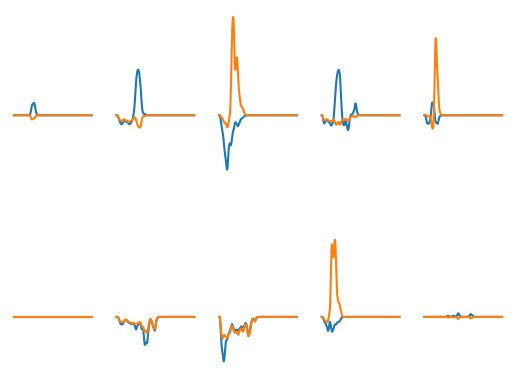

In [ ]:
fig=plt.figure(dpi=100)
plot_voltage_traces(output)

The following shows the activity of the first 1000 neurons of the hidden layer for 1000 timesteps.

In [ ]:
data_id = 0 # Index of sample in first batch
image_data = spk_rec[data_id].detach().cpu().T.numpy()[0:1000, 0:1000]

plot_neuron_activity(image_data, "Hidden Layer Spiking Activity", 'Timesteps', 'Hidden Layer Neurons')

We see that spiking in the hidden layer is quite sparse because we used an activity regularizer.